In [1]:
%matplotlib inline
import logging
import hydra
import pandas as pd

from matplotlib import pyplot as plt
import matplotlib.dates as mdates
from itertools import islice

from gluonts.evaluation import make_evaluation_predictions, Evaluator
from gluonts.dataset.repository.datasets import get_dataset

from load.load_prepare import prepare_data
from domain.estimator import TFTEstimator
from omegaconf import DictConfig, OmegaConf
from configs import Configs

/Users/gsaes/opt/anaconda3/envs/dl4tsf/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
with hydra.initialize(version_base="1.3", config_path="configs"):
    cfgHydra = hydra.compose(config_name="config")

cfg = OmegaConf.to_object(cfgHydra)
cfg: Configs = Configs(**cfg)

In [3]:
dataset = get_dataset("traffic")
train_dataset, test_dataset = prepare_data(cfg=cfg)

100%|██████████| 3/3 [00:00<00:00, 32.76it/s]


In [19]:
dataset.train

[{'target': [0.004800000227987766,
   0.007199999876320362,
   0.004000000189989805,
   0.0038999998942017555,
   0.00419999985024333,
   0.004000000189989805,
   0.004399999976158142,
   0.00419999985024333,
   0.00860000029206276,
   0.022299999371170998,
   0.03269999846816063,
   0.04089999943971634,
   0.045099999755620956,
   0.04619999974966049,
   0.049800001084804535,
   0.043699998408555984,
   0.043699998408555984,
   0.040699999779462814,
   0.037700001150369644,
   0.029500000178813934,
   0.02590000070631504,
   0.01360000018030405,
   0.008200000040233135,
   0.0038999998942017555,
   0.0038999998942017555,
   0.004000000189989805,
   0.003800000064074993,
   0.003700000001117587,
   0.004100000020116568,
   0.022600000724196434,
   0.042899999767541885,
   0.0421999990940094,
   0.04529999941587448,
   0.05490000173449516,
   0.05770000070333481,
   0.061400000005960464,
   0.0658000037074089,
   0.06300000101327896,
   0.06520000100135803,
   0.0649000033736229,
   0.0

In [4]:
estimator = TFTEstimator(
    
    freq = cfg.dataset.freq,
    input_size = cfg.model.model_config['input_size'],
    prediction_length = cfg.model.model_config['prediction_length'],
    context_length = cfg.model.model_config['context_length'],
    lags_seq = cfg.model.model_config['lags_sequence'],
    dropout = cfg.model.model_config['dropout'],
    
    num_feat_static_cat = 1,
    cardinality=[861],
    scaling=False,

    #batch_size=128,
    num_batches_per_epoch=cfg.train.nb_batch_per_epoch,

    trainer_kwargs=dict(
    gpus = None, 
    max_epochs = cfg.train.epochs, 
    limit_train_batches=cfg.train.batch_size_train,  
    gradient_clip_val = 10.,  
    ),
)

In [14]:
predictor = estimator.train(
    training_data = dataset.train,
    cache_data=True,
    #num_workers=8,
    #shuffle_buffer_length=1024
)

/Users/gsaes/opt/anaconda3/envs/dl4tsf/lib/python3.8/site-packages/pytorch_lightning/utilities/parsing.py:269: UserWarning: Attribute 'model' is an instance of `nn.Module` and is already saved during checkpointing. It is recommended to ignore them using `self.save_hyperparameters(ignore=['model'])`.
  rank_zero_warn(
GPU available: False, used: False
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
`Trainer(limit_train_batches=1)` was configured so 1 batch per epoch will be used.
/Users/gsaes/opt/anaconda3/envs/dl4tsf/lib/python3.8/site-packages/pytorch_lightning/trainer/configuration_validator.py:108: PossibleUserWarning: You defined a `validation_step` but have no `val_dataloader`. Skipping val loop.
  rank_zero_warn(

  | Name  | Type     | Params
-----------------------------------
0 | model | TFTModel | 120 K 
-----------------------------------
120 K     Trainable params
0         Non-trainable params
120 K     Total

Epoch 0: 100%|██████████| 1/1.0 [00:00<00:00,  3.33it/s, loss=0.88, v_num=42, train_loss=0.880]

Epoch 0, global step 1: 'train_loss' reached 0.87962 (best 0.87962), saving model to '/Users/gsaes/Projets/Transformers_Time_Series/dl4tsf/dl4tsf/lightning_logs/version_42/checkpoints/epoch=0-step=1.ckpt' as top 1
`Trainer.fit` stopped: `max_epochs=1` reached.


Epoch 0: 100%|██████████| 1/1.0 [00:04<00:00,  4.10s/it, loss=0.88, v_num=42, train_loss=0.880]


In [15]:
forecast_it, ts_it = make_evaluation_predictions(
    dataset=dataset.test,
    predictor=predictor
)

In [ ]:
forecasts = list(forecast_it)

In [ ]:
tss = list(ts_it)

In [12]:
evaluator = Evaluator(
    quantiles = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9],
    seasonality=1,
    )

In [ ]:
agg_metrics, ts_metrics = evaluator(
    ts_iterator = tss,
    fcst_iterator = forecasts,
    )
agg_metrics

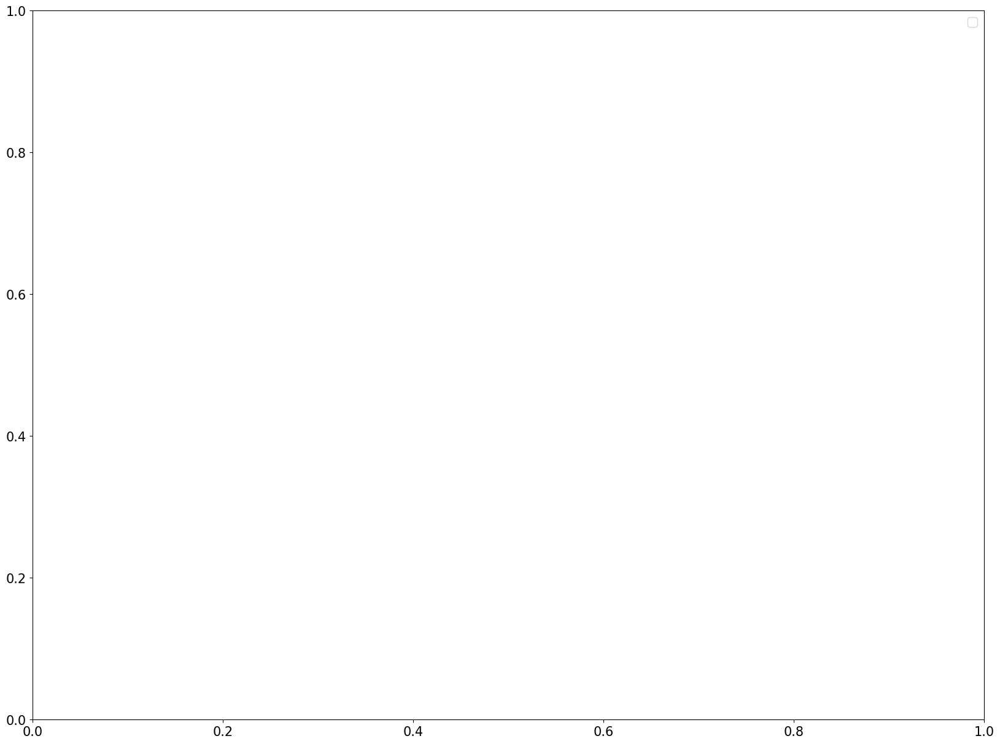

In [46]:
plt.figure(figsize=(20, 15))
date_formater = mdates.DateFormatter('%b, %d')
plt.rcParams.update({'font.size': 15})

for idx, (forecast, ts) in islice(enumerate(zip(forecasts, tss)), 9):
    ax = plt.subplot(3, 3, idx+1)

    plt.plot(ts[-4 * dataset.metadata.prediction_length:], label="target", )
    forecast.plot( color='g')
    plt.xticks(rotation=60)
    plt.title(forecast.item_id)
    ax.xaxis.set_major_formatter(date_formater)

plt.gcf().tight_layout()
plt.legend()
plt.show()